# Fast Food Classification

this notebook have reference from https://www.kaggle.com/code/utkarshsaxenadn/fast-food-classification-resnet50v2-acc-92/notebook

## Get Data

The dataset use in this notebook are from https://www.kaggle.com/datasets/utkarshsaxenadn/fast-food-classification-dataset/versions/1

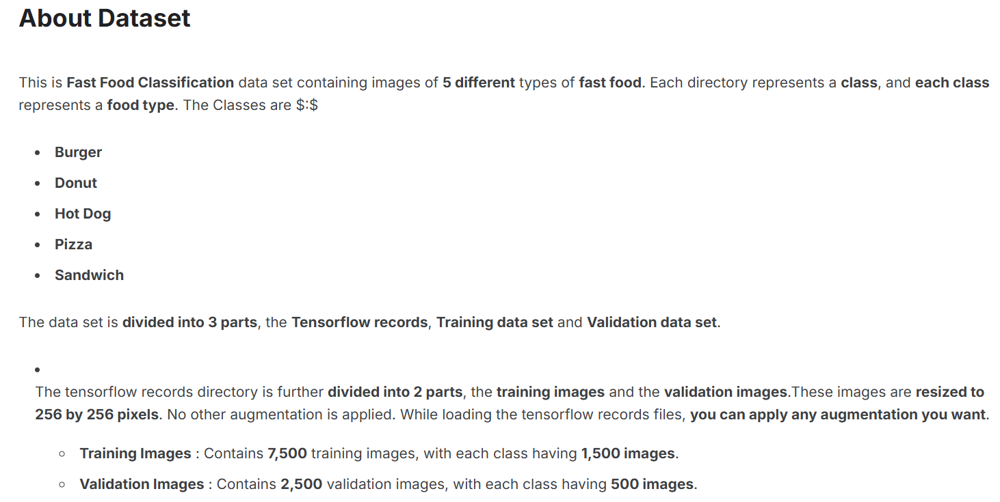

mount with google drive to get file

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Path to uploaded zip file
zip_path = "/content/drive/MyDrive/FoodClassification/datasetv1.zip"

# Unzip it to /content/data
!unzip -q "$zip_path" -d /content/data

## Environment Setup

In [ ]:
# Common
import os
import numpy as np
import tensorflow as tf

# TFRecords Loading
from tensorflow import io
from tensorflow import data as tfd
from tensorflow import train as tft
from tensorflow import image as tfi

# Data Loading
from keras.utils import image_dataset_from_directory # Import image_dataset_from_directory

# Data Visualization
import plotly.express as px
import matplotlib.pyplot as plt

# Models
from keras.layers import Dense, GlobalAveragePooling2D as GAP, Dropout
from keras.models import load_model, Sequential

# Pre Trained Models
from tensorflow.keras.applications import ResNet50V2, InceptionV3, EfficientNetB0

# Callbacks
from keras.callbacks import EarlyStopping, ModelCheckpoint

In [ ]:
os.environ['ENABLE_AUTO_MIXED_PRECISION']  = '1'

## Data Distribution

In [ ]:
train_path = '/content/data/Fast Food Data/Training Data'
valid_path = '/content/data/Fast Food Data/Validation Data'

In [ ]:
# Collecte the class names.
class_names = sorted(os.listdir(train_path))
n_classes = len(class_names)

# Print
print("No. Classes : {}".format(n_classes))
print("Classes     : {}".format(class_names))

No. Classes : 5
Classes     : ['Burger', 'Donut', 'Hot Dog', 'Pizza', 'Sandwich']


In [ ]:
# Calculate the class distribution
class_dis = [len(os.listdir(os.path.join(train_path, name))) for name in class_names] # Use os.path.join to correctly construct the path

# Virtualize class distribution
fig = px.pie(names=class_names, values=class_dis, hole=0.3)
fig.update_layout({"title":{'text':"Training Class Distribution", 'x':0.48}})
fig.show()

fig = px.bar(x=class_names, y=class_dis, color=class_names)
fig.show()

In [ ]:
# Calculate the class distribution
class_dis = [len(os.path.join(valid_path + name)) for name in class_names]

# Virtualize class distribution
fig = px.pie(names=class_names, values=class_dis, hole=0.3)
fig.update_layout({"title":{'text':"Validation Class Distribution", 'x':0.48}})
fig.show()

fig = px.bar(x=class_names, y=class_dis, color=class_names)
fig.show()

## Load Dataset from folder

ImageDataGenerator: this function do data augmentation by rotation_range = 10 | horizontal flip | rescale = 1/255

In [ ]:
# Import the ImageDataGenerator class from tf.keras.preprocessing.image
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Initialize image data generator
# Use ImageDataGenerator instead of IDG
train_gen = ImageDataGenerator(rescale=1./255, rotation_range=10, horizontal_flip=True, vertical_flip=False)
valid_gen = ImageDataGenerator(rescale=1./255)

# Load the datasets
train_ds = train_gen.flow_from_directory(train_path, shuffle=True, batch_size=64, target_size=(256,256), class_mode='categorical')
valid_ds = valid_gen.flow_from_directory(valid_path, shuffle=False, batch_size=32, target_size=(256,256), class_mode='categorical')

Found 7500 images belonging to 5 classes.
Found 2500 images belonging to 5 classes.


## Data Visulization

In [ ]:
def show_images(data, class_names=class_names, GRID=[3,6], figsize=(25,15), model=None):

    # Plot configurations
    n_rows, n_cols = GRID
    n_images = n_rows * n_cols
    plt.figure(figsize=figsize)

    n=1
    for images, labels in iter(data):

        # Select a random image and label.
        idx = np.random.randint(len(images))
        image, label = images[idx], class_names[np.argmax(labels[idx])]

        # Plot image
        plt.subplot(n_rows, n_cols, n)
        title = f"True : {label}"
        if model is not None:
            pred = class_names[np.argmax(model.predict(image[np.newaxis,...])[0])]
            title = f"True : {label}\nPred : {pred}"
        plt.imshow(image)
        plt.title(title)
        plt.axis('off')

        n+=1
        if n>=(n_images+1):
            break

    plt.show()

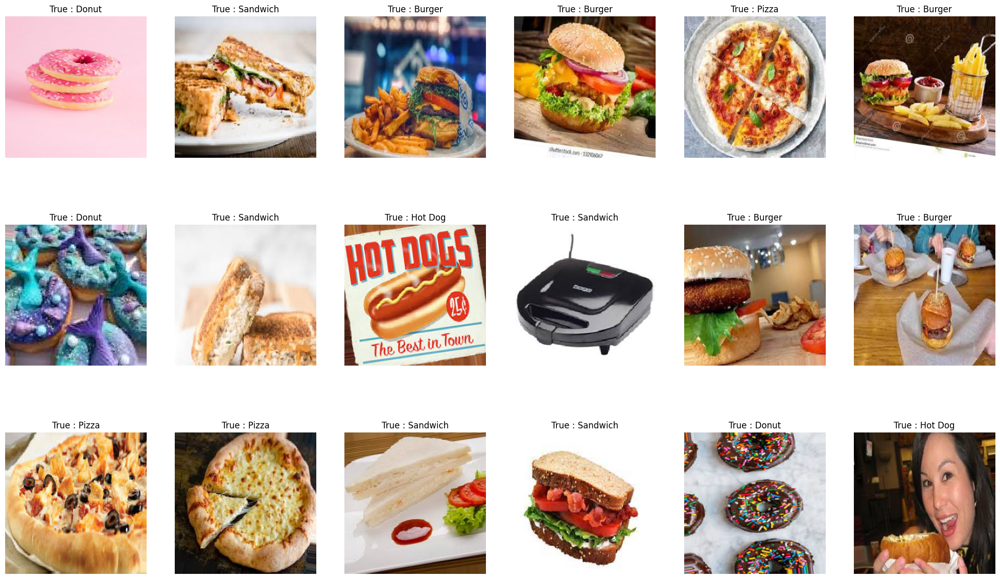

In [ ]:
show_images(data=train_ds)

## TFRecords Loading

the process_data function use tfi.random_brightness which is applies random brightness adjustment to image loaded from TFRecords

In [ ]:
def process_data(image):
    image = tfi.decode_jpeg(image, channels=3)
    image = tfi.random_brightness(image, max_delta=0.2)
    image = tf.cast(image, tf.float32)/255.
    return image

def cvt_to_image_label(example):
    ground_truth = {
        'label':io.FixedLenFeature([], tf.int64),
        'image':io.FixedLenFeature([], tf.string)
    }

    example = io.parse_single_example(example, ground_truth)
    images, labels = example['image'], example['label']
    images = process_data(images)
    return images, labels

In [ ]:
# Specify the Path
file_pattern = '/content/data/Fast Food Data/TFRecords Data/Training Images/*.tfrecord'
files = tfd.Dataset.list_files(file_pattern)

# Load The Data
data = tfd.TFRecordDataset(files)
data = data.map(cvt_to_image_label, num_parallel_calls=tfd.AUTOTUNE)
data = data.cache().repeat(1).shuffle(2048)
train_tf_ds = data.batch(64, drop_remainder=True).prefetch(tfd.AUTOTUNE)

In [ ]:
# Specify the Path
file_pattern = '/content/data/Fast Food Data/TFRecords Data/Validation Images/*.tfrecord'
files = tfd.Dataset.list_files(file_pattern)

# Load The Data
data = tfd.TFRecordDataset(files)
data = data.map(cvt_to_image_label, num_parallel_calls=tfd.AUTOTUNE)
data = data.cache().repeat(1).shuffle(2048)
valid_tf_ds = data.batch(64, drop_remainder=True).prefetch(tfd.AUTOTUNE)

Data Visualization

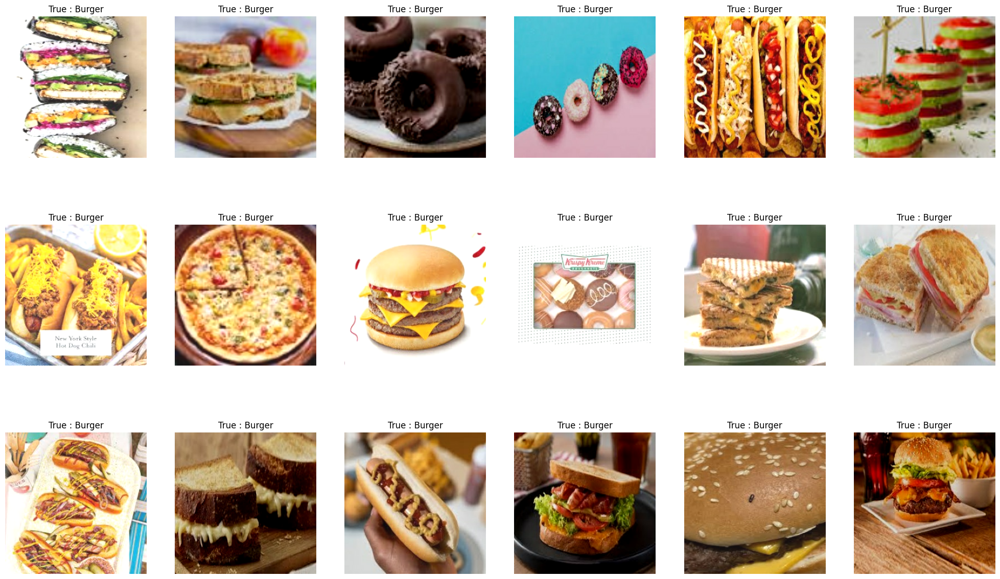

In [ ]:
show_images(data=train_tf_ds)

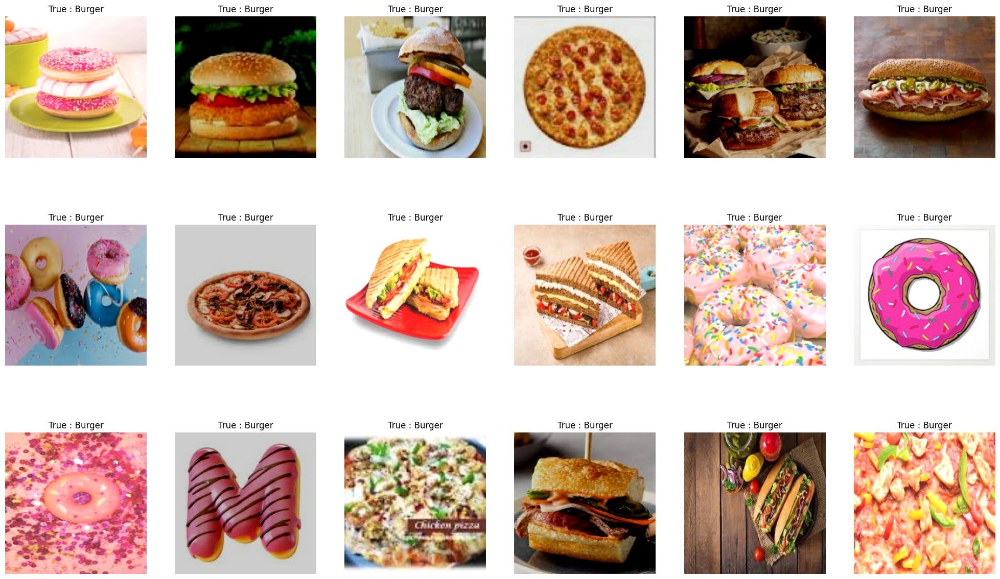

In [ ]:
show_images(data=valid_tf_ds)

## MODEL: ResNet50V2

In [ ]:
# Base Model
base = ResNet50V2(include_top=False, input_shape=(256,256,3))
base.trainable = False

# Model Architecture
model = Sequential([
    base, GAP(),
    Dense(1024, kernel_initializer='he_normal', activation='relu'),
    Dropout(0.4),
    Dense(n_classes, activation='softmax')
])

# Callbacks
cbs = [
    EarlyStopping(patience=3, restore_best_weights=True),
    ModelCheckpoint('ResNet50V2.keras', save_best_only=True)
]

# Compile
model.compile(
    loss='categorical_crossentropy',
    optimizer=tf.keras.optimizers.Adam(learning_rate=2e-3),
    metrics=['accuracy']
)

94668760/94668760 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


### Train and Evaluate Models

In [ ]:
# Train
history = model.fit(train_ds, validation_data=valid_ds, epochs=10, callbacks=cbs)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning:

Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.



Epoch 1/10
 41/118 ━━━━━━━━━━━━━━━━━━━━ 1:21 1s/step - accuracy: 0.6591 - loss: 1.4513

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1043: UserWarning:

Palette images with Transparency expressed in bytes should be converted to RGBA images



118/118 ━━━━━━━━━━━━━━━━━━━━ 168s 1s/step - accuracy: 0.7640 - loss: 0.9361 - val_accuracy: 0.8688 - val_loss: 0.3870
Epoch 2/10
118/118 ━━━━━━━━━━━━━━━━━━━━ 173s 1s/step - accuracy: 0.8964 - loss: 0.3009 - val_accuracy: 0.8580 - val_loss: 0.4274
Epoch 3/10
118/118 ━━━━━━━━━━━━━━━━━━━━ 135s 1s/step - accuracy: 0.9218 - loss: 0.2332 - val_accuracy: 0.8820 - val_loss: 0.3553
Epoch 4/10
118/118 ━━━━━━━━━━━━━━━━━━━━ 130s 1s/step - accuracy: 0.9279 - loss: 0.2074 - val_accuracy: 0.8580 - val_loss: 0.4381
Epoch 5/10
118/118 ━━━━━━━━━━━━━━━━━━━━ 142s 1s/step - accuracy: 0.9390 - loss: 0.1938 - val_accuracy: 0.8752 - val_loss: 0.3845
Epoch 6/10
118/118 ━━━━━━━━━━━━━━━━━━━━ 129s 1s/step - accuracy: 0.9497 - loss: 0.1464 - val_accuracy: 0.8772 - val_loss: 0.4378


In [ ]:
# Evaluate
loss, accuracy = model.evaluate(valid_ds, verbose=2)

print('Validation accuracy:', accuracy)
print('Validation loss:', loss)

79/79 - 7s - 91ms/step - accuracy: 0.8820 - loss: 0.3553
Validation accuracy: 0.8820000290870667
Validation loss: 0.3552858829498291


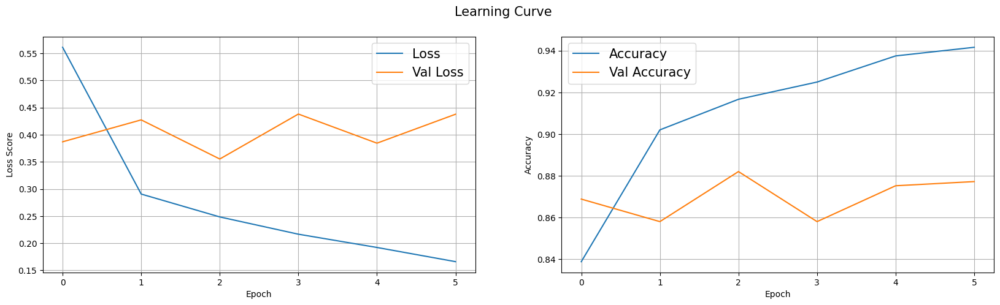

In [ ]:
# Data Visualization
plt.figure(figsize=(20,5))
plt.suptitle("Learning Curve", fontsize=15)

plt.subplot(1,2,1)
plt.plot(history.history['loss'], label="Loss")
plt.plot(history.history['val_loss'], label="Val Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss Score")
plt.grid()
plt.legend(fontsize=15)

plt.subplot(1,2,2)
plt.plot(history.history['accuracy'], label="Accuracy")
plt.plot(history.history['val_accuracy'], label="Val Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.grid()
plt.legend(fontsize=15)

plt.show()

In [ ]:
model = load_model('/content/ResNet50V2.keras')
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50v2 (Functional)         │ (None, 8, 8, 2048)     │    23,564,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1024)           │     2,098,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 5)              │         5,125 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 29,874,705 (113.96 MB)

 Trainable params: 2,103,301 (8.02 MB)

 Non-trainable params: 23,564,800 (89.89 MB)

 Optimizer params: 4,206,604 (16.05 MB)

In [ ]:
from sklearn.metrics import classification_report
import numpy as np

# Step 1: Get ground truth labels from the generator
true_labels = valid_ds.classes

# Step 2: Predict probabilities
pred_probs = model.predict(valid_ds)

# Step 3: Get predicted class indices
pred_labels = np.argmax(pred_probs, axis=1)

# Step 4: Print classification report
print(classification_report(true_labels, pred_labels, target_names=list(valid_ds.class_indices.keys())))


79/79 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step
              precision    recall  f1-score   support

      Burger       0.86      0.91      0.88       500
       Donut       0.89      0.93      0.91       500
     Hot Dog       0.90      0.78      0.84       500
       Pizza       0.95      0.93      0.94       500
    Sandwich       0.82      0.86      0.84       500

    accuracy                           0.88      2500
   macro avg       0.88      0.88      0.88      2500
weighted avg       0.88      0.88      0.88      2500



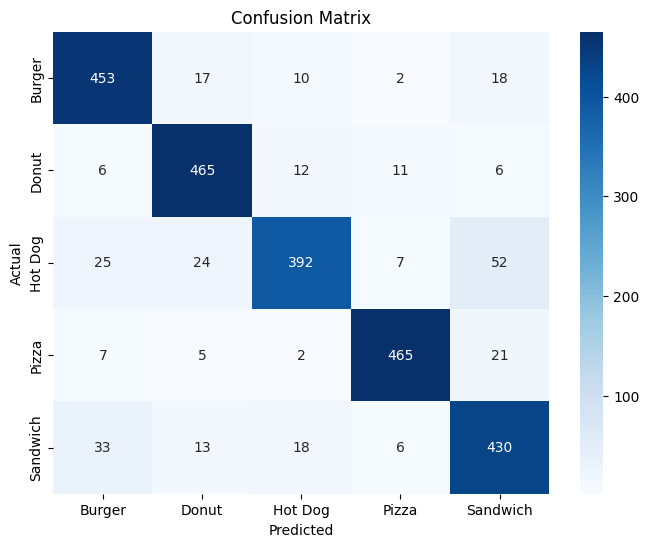

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(true_labels, pred_labels)

plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=valid_ds.class_indices.keys(), yticklabels=valid_ds.class_indices.keys())
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def show_pred_images(data, model, GRID=[5,5], figsize=(20,25)):
    class_names = list(data.class_indices.keys())
    x_batch, y_batch = next(data)  # Fetch one batch of images and labels
    preds = model.predict(x_batch)
    pred_classes = np.argmax(preds, axis=1)

    plt.figure(figsize=figsize)
    for i in range(GRID[0] * GRID[1]):
        plt.subplot(GRID[0], GRID[1], i+1)
        plt.imshow(x_batch[i])

        # Convert one-hot encoded label to its index
        actual = class_names[np.argmax(y_batch[i])]
        predicted = class_names[int(pred_classes[i])]

        color = "green" if actual == predicted else "red"
        plt.title(f"Actual: {actual}\nPred: {predicted}", color=color)
        plt.axis("off")

    plt.tight_layout()
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


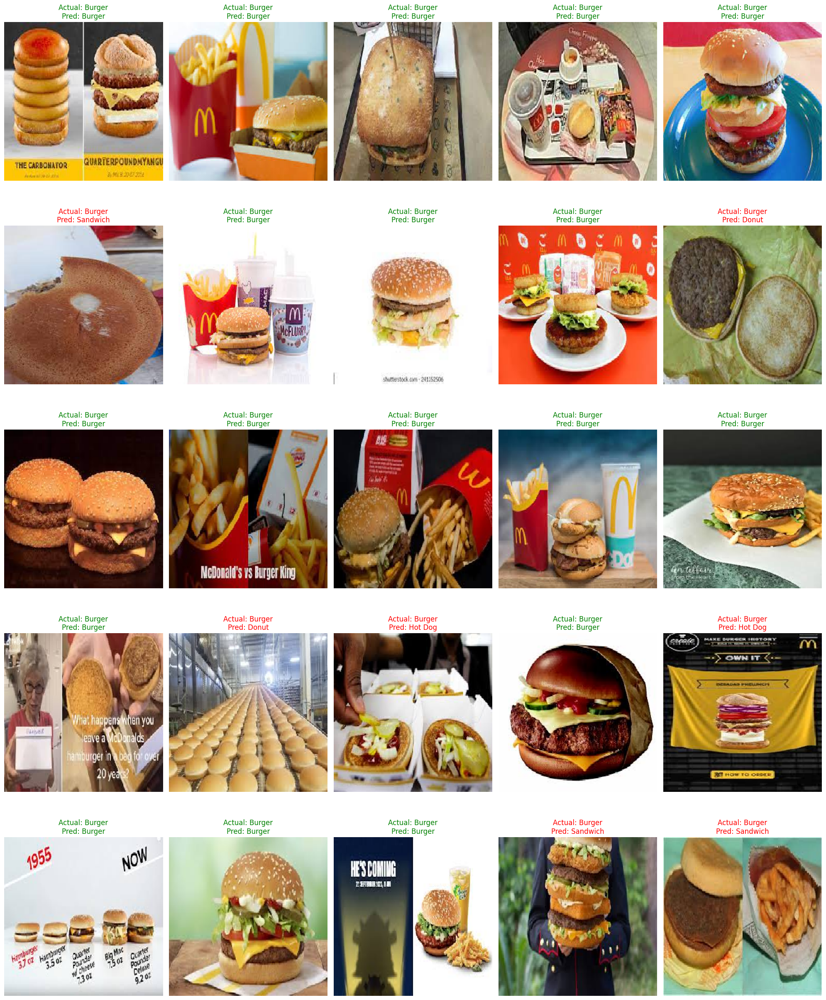

In [ ]:
show_pred_images(data=valid_ds, model=model, GRID=[5,5], figsize=(20,25))

## MODEL: InceptionV3

In [ ]:
# Base Model
base = InceptionV3(include_top=False, input_shape=(256,256,3))
base.trainable = False

# Model Architecture
model = Sequential([
    base, GAP(),
    Dense(1024, kernel_initializer='he_normal', activation='relu'),
    Dropout(0.4),
    Dense(n_classes, activation='softmax')
])

# Callbacks
cbs = [
    EarlyStopping(patience=3, restore_best_weights=True),
    ModelCheckpoint('InceptionV3.keras', save_best_only=True)
]

# Compile
model.compile(
    loss='categorical_crossentropy',
    optimizer=tf.keras.optimizers.Adam(learning_rate=2e-3),
    metrics=['accuracy']
)

### Train and Evaluate Models

In [ ]:
# Train
import time
start_time = time.time()
history = model.fit(train_ds, validation_data=valid_ds, epochs=10, callbacks=cbs)
end_time = time.time()
print(f"Training time: {end_time - start_time} seconds")

Epoch 1/10
 33/118 ━━━━━━━━━━━━━━━━━━━━ 1:23 984ms/step - accuracy: 0.5611 - loss: 2.7498

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1043: UserWarning:

Palette images with Transparency expressed in bytes should be converted to RGBA images



118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.7140 - loss: 1.5090

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning:

Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.



118/118 ━━━━━━━━━━━━━━━━━━━━ 173s 1s/step - accuracy: 0.7148 - loss: 1.5027 - val_accuracy: 0.8712 - val_loss: 0.3766
Epoch 2/10
118/118 ━━━━━━━━━━━━━━━━━━━━ 163s 1s/step - accuracy: 0.8804 - loss: 0.3697 - val_accuracy: 0.8800 - val_loss: 0.3431
Epoch 3/10
118/118 ━━━━━━━━━━━━━━━━━━━━ 128s 1s/step - accuracy: 0.8984 - loss: 0.3076 - val_accuracy: 0.8804 - val_loss: 0.3486
Epoch 4/10
118/118 ━━━━━━━━━━━━━━━━━━━━ 131s 1s/step - accuracy: 0.8986 - loss: 0.3003 - val_accuracy: 0.8684 - val_loss: 0.3851
Epoch 5/10
118/118 ━━━━━━━━━━━━━━━━━━━━ 127s 1s/step - accuracy: 0.8994 - loss: 0.2785 - val_accuracy: 0.8552 - val_loss: 0.4488
Training time: 724.0343701839447 seconds


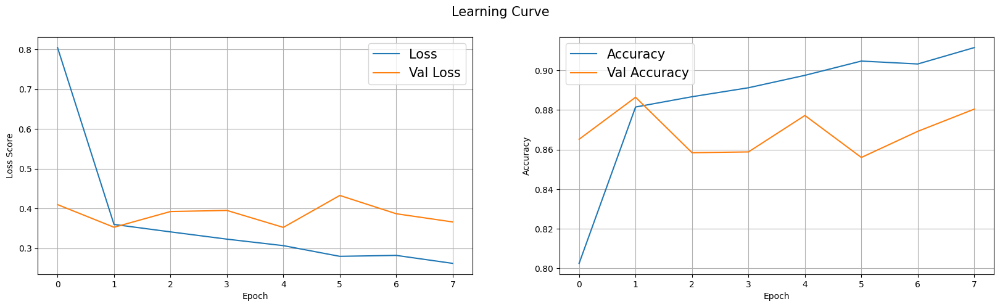

In [ ]:
# Data Visualization
plt.figure(figsize=(20,5))
plt.suptitle("Learning Curve", fontsize=15)

plt.subplot(1,2,1)
plt.plot(history.history['loss'], label="Loss")
plt.plot(history.history['val_loss'], label="Val Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss Score")
plt.grid()
plt.legend(fontsize=15)

plt.subplot(1,2,2)
plt.plot(history.history['accuracy'], label="Accuracy")
plt.plot(history.history['val_accuracy'], label="Val Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.grid()
plt.legend(fontsize=15)

plt.show()

In [ ]:
model = load_model('/content/InceptionV3.keras')
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ inception_v3 (Functional)       │ (None, 6, 6, 2048)     │    21,802,784 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_2      │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 1024)           │     2,098,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 5)              │         5,125 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,112,689 (107.24 MB)

 Trainable params: 2,103,301 (8.02 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

 Optimizer params: 4,206,604 (16.05 MB)

In [ ]:
from sklearn.metrics import classification_report
import numpy as np

# Step 1: Get ground truth labels from the generator
true_labels = valid_ds.classes

# Step 2: Predict probabilities
pred_probs = model.predict(valid_ds)

# Step 3: Get predicted class indices
pred_labels = np.argmax(pred_probs, axis=1)

# Step 4: Print classification report
print(classification_report(true_labels, pred_labels, target_names=list(valid_ds.class_indices.keys())))


79/79 ━━━━━━━━━━━━━━━━━━━━ 19s 169ms/step
              precision    recall  f1-score   support

      Burger       0.86      0.89      0.87       500
       Donut       0.95      0.89      0.92       500
     Hot Dog       0.85      0.85      0.85       500
       Pizza       0.96      0.90      0.93       500
    Sandwich       0.79      0.86      0.82       500

    accuracy                           0.88      2500
   macro avg       0.88      0.88      0.88      2500
weighted avg       0.88      0.88      0.88      2500



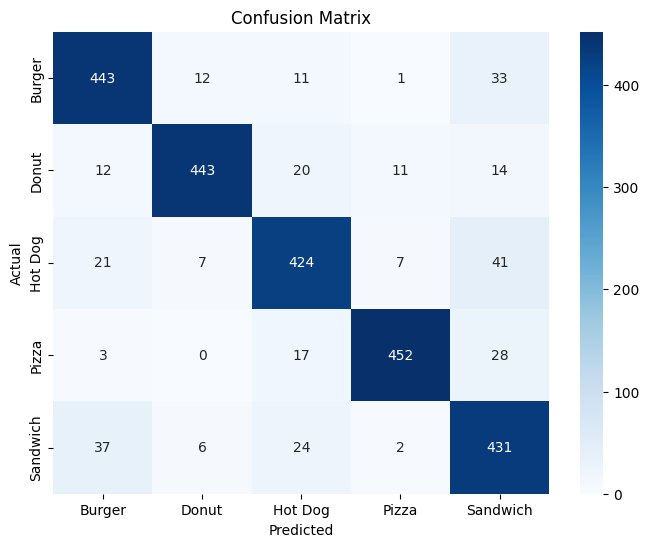

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(true_labels, pred_labels)

plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=valid_ds.class_indices.keys(), yticklabels=valid_ds.class_indices.keys())
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


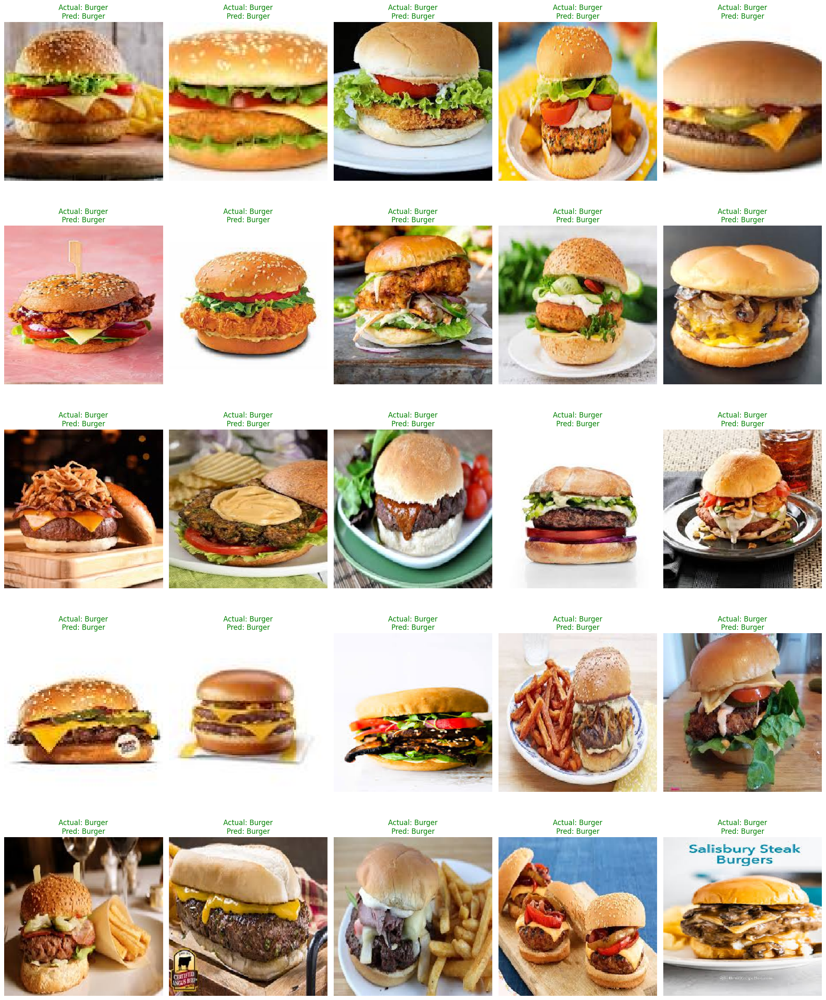

In [ ]:
show_pred_images(data=valid_ds, model=model, GRID=[5,5], figsize=(20,25))

## MODEL: EfficientNetB0